In [1]:
import sys, os
import json
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from functools import partial
import seaborn as sns
sys.path.append(os.path.join(os.getcwd(), '..'))
from src.util import *

In [2]:
with open('../data/params.json', 'r') as f:
    params = json.load(f)

nsim = params.get('nsim', 10000)
nepisode_train = params.get('nepisode_train', 3000)
nepisode_eval = params.get('nepisode_eval', 500)
nstep = params.get('nstep', 365)
t1 = params.get('t1', 0)
k = params.get('k', 100)

with open('../data/results.pkl', 'rb') as f:
    results = pickle.load(f)

df = pd.read_csv('../data/test_cases.csv', usecols=range(0, 14))

In [3]:
# mean_rewards = []
# for index, row in df.iterrows():
#     mean_reward = results[index][0]  
#     mean_rewards.append(mean_reward)
df['RL_Price'] = [x[0] for x in results]

In [4]:
df['European_Price'] = df.apply(
    lambda row: black_scholes(
        s=row['s_0'],
        k=k, 
        t1 = t1,
        t2=row['t2'],
        r=row['r'],
        v=row['v'] if not np.isnan(row['v']) else row['sigma'],  
        q = row['q'],
        call=row['h'].split('_')[-1].lower() == "call"
    ),
    axis=1
)

In [5]:
df['MC_Price'] = df.apply(
    lambda row: get_mc_price(
        generate_gbm_paths(
            nsim=1000,
            nstep=nstep,
            t1=t1,
            t2=row["t2"],
            s_0=row["s_0"],
            r=row["r"],
            q=row["q"],
            v=row["v"]
        ) if row["gbm"] else generate_heston_paths(
            nsim=1000,
            nstep=nstep,
            t1=t1,
            t2=row["t2"],
            s_0=row["s_0"],
            r=row["r"],
            q=row["q"],
            v_0=row["v_0"],
            theta=row["theta"],
            rho=row["rho"],
            kappa=row["kappa"],
            sigma=row["sigma"]
        ),
        t1=t1,
        t2=row["t2"],
        h=(call if row["h"].split('_')[-1].lower() == "call" else put), 
        k=k,
        r=row["r"]
    ),
    axis=1
)

In [6]:
# Relative differences
df["RL_vs_MC"] = (df["RL_Price"] - df["MC_Price"]) / df["MC_Price"]
df["RL_vs_European"] = (df["RL_Price"] - df["European_Price"]) / df["European_Price"]

# Value of Early Exercise
df['Early_Exe_Value_RL'] = df['RL_Price'] - df['European_Price']
df['Early_Exe_Value_MC'] = df['MC_Price'] - df['European_Price']

## Testing pricing consistency/accuracy on American Put-Options

### K = 100, r = 4%

In [7]:
rel_col1 = ["s_0", "v", "t2", "RL_Price", "European_Price", "MC_Price"]
BC_gbm = df[(df["case"] == "Base_Case") & (df["gbm"] == True)]
BC_gbm[rel_col1]

,s_0,v,t2,RL_Price,European_Price,MC_Price
0,80,0.2,1.0,22.143752,17.784517,20.086974
2,80,0.2,2.0,22.917138,17.049533,20.468250
4,80,0.4,1.0,26.862564,23.409238,24.197792
6,80,0.4,2.0,29.560591,25.936587,28.489160
8,90,0.2,1.0,13.838910,10.841383,11.615698
10,90,0.2,2.0,15.372856,11.448371,13.383451
12,90,0.4,1.0,19.156382,17.981800,18.434520
14,90,0.4,2.0,21.113964,21.476312,24.366860
16,100,0.2,1.0,5.745424,6.003998,6.934603
18,100,0.2,2.0,8.536513,7.396337,8.408199


In [8]:
rel_col_h = ["s_0", 'v_0', 'theta', 'rho', 'kappa', 'sigma', "t2", "RL_Price", "European_Price", "MC_Price"]
BC_hest = df[(df["case"] == "Base_Case") & (df["gbm"] == False)]
BC_hest[rel_col_h]

,s_0,v_0,theta,rho,kappa,sigma,t2,RL_Price,European_Price,MC_Price
1,80,0.04,0.04,-0.7,2.0,0.2,1.0,23.462960,17.784517,20.200614
3,80,0.04,0.04,-0.7,2.0,0.2,2.0,24.463557,17.049533,20.066444
5,80,0.16,0.16,-0.7,2.0,0.4,1.0,27.396500,23.409238,24.479574
7,80,0.16,0.16,-0.7,2.0,0.4,2.0,30.805522,25.936587,26.904555
9,90,0.04,0.04,-0.7,2.0,0.2,1.0,14.070079,10.841383,11.324129
11,90,0.04,0.04,-0.7,2.0,0.2,2.0,15.702920,11.448371,12.921983
13,90,0.16,0.16,-0.7,2.0,0.4,1.0,18.751305,17.981800,18.200568
15,90,0.16,0.16,-0.7,2.0,0.4,2.0,23.054861,21.476312,21.730536
17,100,0.04,0.04,-0.7,2.0,0.2,1.0,6.186808,6.003998,6.633298
19,100,0.04,0.04,-0.7,2.0,0.2,2.0,7.700248,7.396337,8.939643


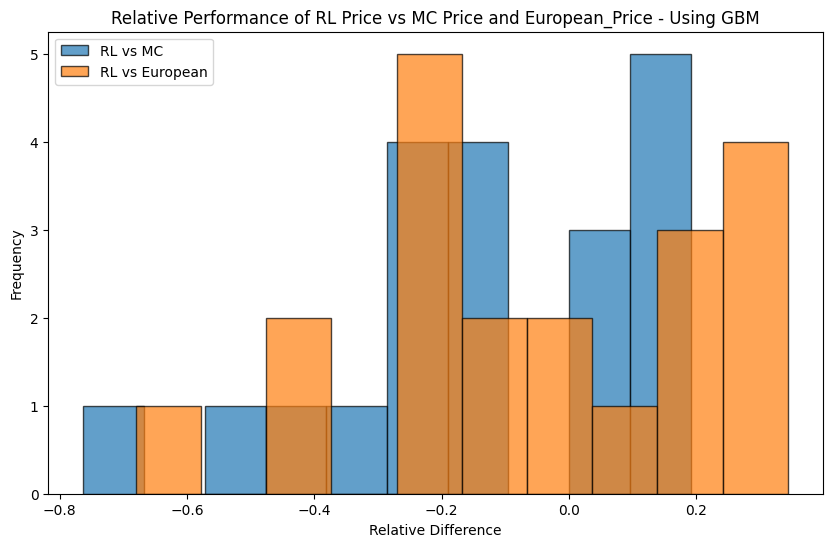

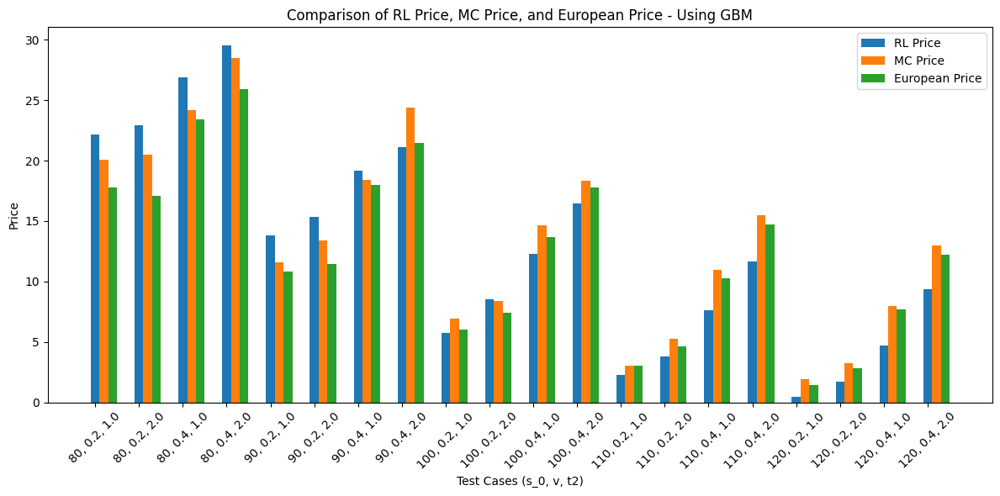

In [9]:
# Relative Performance
plt.figure(figsize=(10, 6))
plt.hist(BC_gbm["RL_vs_MC"], bins=10, alpha=0.7, label="RL vs MC", edgecolor="black")
plt.hist(BC_gbm["RL_vs_European"], bins=10, alpha=0.7, label="RL vs European", edgecolor="black")
plt.title("Relative Performance of RL Price vs MC Price and European_Price - Using GBM")
plt.xlabel("Relative Difference")
plt.ylabel("Frequency")
plt.legend()
plt.show()


# Comparing RL_Price, MC_Price, and European_Price
plt.figure(figsize=(12, 6))
x = range(len(BC_gbm))
plt.bar(x, BC_gbm["RL_Price"], width=0.2, label="RL Price")
plt.bar([i + 0.2 for i in x], BC_gbm["MC_Price"], width=0.2, label="MC Price")
plt.bar([i + 0.4 for i in x], BC_gbm["European_Price"], width=0.2, label="European Price")
plt.xticks(x, [f"{row['s_0']}, {row['v']}, {row['t2']}" for _, row in BC_gbm.iterrows()], rotation=45)
plt.title("Comparison of RL Price, MC Price, and European Price - Using GBM")
plt.xlabel("Test Cases (s_0, v, t2)")
plt.ylabel("Price")
plt.legend()
plt.tight_layout()
plt.show()

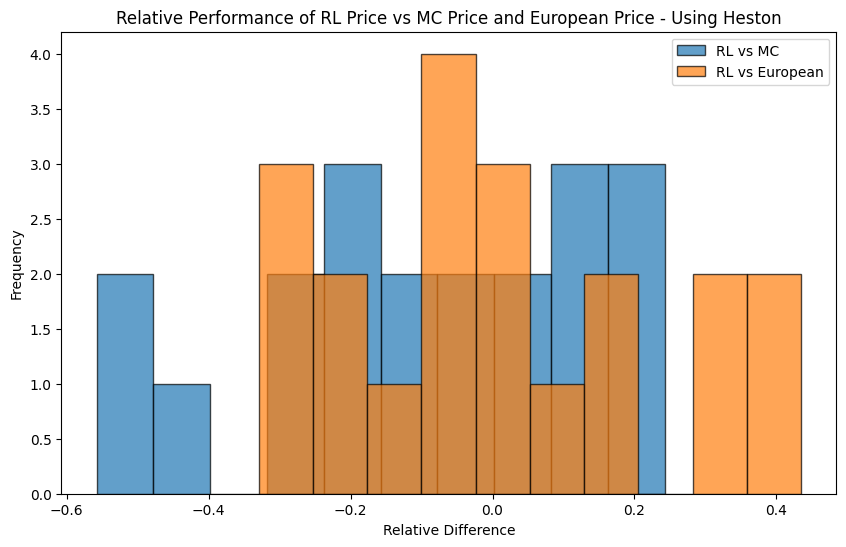

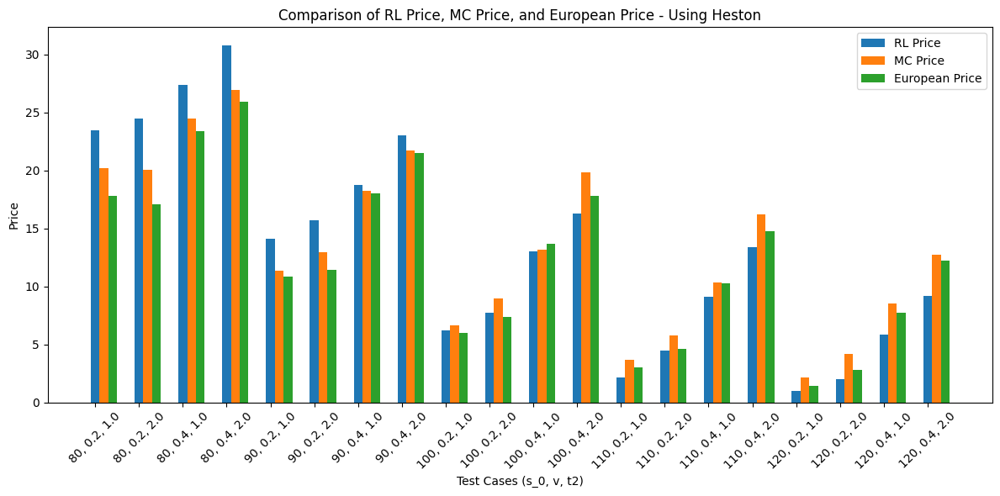

In [10]:
# Relative Performance
plt.figure(figsize=(10, 6))
plt.hist(BC_hest["RL_vs_MC"], bins=10, alpha=0.7, label="RL vs MC", edgecolor="black")
plt.hist(BC_hest["RL_vs_European"], bins=10, alpha=0.7, label="RL vs European", edgecolor="black")
plt.title("Relative Performance of RL Price vs MC Price and European Price - Using Heston")
plt.xlabel("Relative Difference")
plt.ylabel("Frequency")
plt.legend()
plt.show()


# Comparing RL_Price, MC_Price, and European_Price
plt.figure(figsize=(12, 6))
x = range(len(BC_hest))
plt.bar(x, BC_hest["RL_Price"], width=0.2, label="RL Price")
plt.bar([i + 0.2 for i in x], BC_hest["MC_Price"], width=0.2, label="MC Price")
plt.bar([i + 0.4 for i in x], BC_hest["European_Price"], width=0.2, label="European Price")
plt.xticks(x, [f"{row['s_0']}, {row['sigma']}, {row['t2']}" for _, row in BC_hest.iterrows()], rotation=45)
plt.title("Comparison of RL Price, MC Price, and European Price - Using Heston")
plt.xlabel("Test Cases (s_0, v, t2)")
plt.ylabel("Price")
plt.legend()
plt.tight_layout()
plt.show()

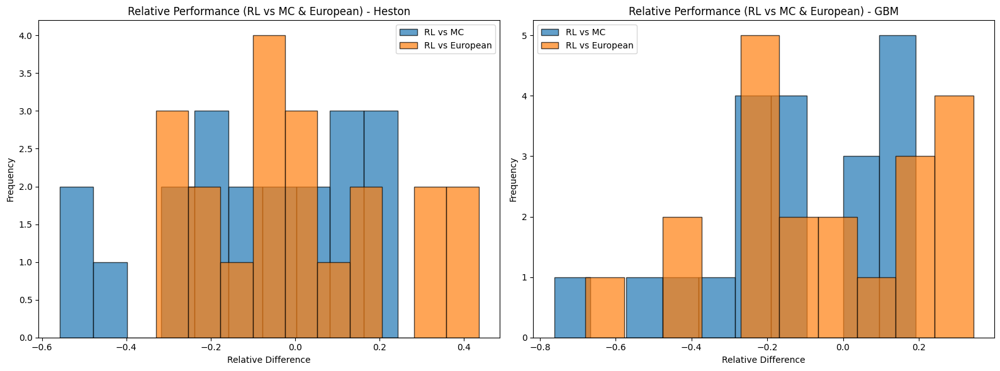

In [11]:
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# First histogram: Relative Performance - Heston
axes[0].hist(BC_hest["RL_vs_MC"], bins=10, alpha=0.7, label="RL vs MC", edgecolor="black")
axes[0].hist(BC_hest["RL_vs_European"], bins=10, alpha=0.7, label="RL vs European", edgecolor="black")
axes[0].set_title("Relative Performance (RL vs MC & European) - Heston")
axes[0].set_xlabel("Relative Difference")
axes[0].set_ylabel("Frequency")
axes[0].legend()

# Second histogram: Relative Performance - GBM
axes[1].hist(BC_gbm["RL_vs_MC"], bins=10, alpha=0.7, label="RL vs MC", edgecolor="black")
axes[1].hist(BC_gbm["RL_vs_European"], bins=10, alpha=0.7, label="RL vs European", edgecolor="black")
axes[1].set_title("Relative Performance (RL vs MC & European) - GBM")
axes[1].set_xlabel("Relative Difference")
axes[1].set_ylabel("Frequency")
axes[1].legend()

# Adjust layout for clarity
plt.tight_layout()
plt.show()

## Value of Early Excercise

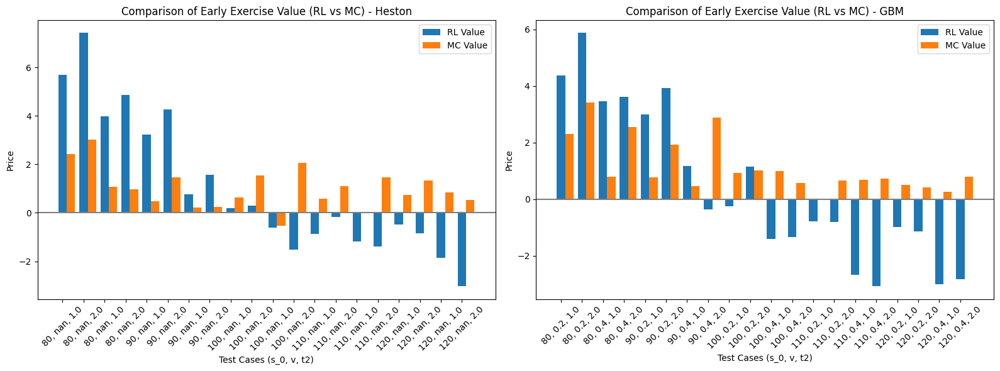

In [12]:
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

#Heston
x_hest = range(len(BC_hest))
axes[0].bar(x_hest, BC_hest["Early_Exe_Value_RL"], width=0.4, label="RL Value")
axes[0].bar([i + 0.4 for i in x_hest], BC_hest["Early_Exe_Value_MC"], width=0.4, label="MC Value")
axes[0].set_xticks(x_hest)
axes[0].set_xticklabels([f"{row['s_0']}, {row['v']}, {row['t2']}" for _, row in BC_hest.iterrows()], rotation=45)
axes[0].set_title("Comparison of Early Exercise Value (RL vs MC) - Heston")
axes[0].set_xlabel("Test Cases (s_0, v, t2)")
axes[0].axhline(color="grey")
axes[0].set_ylabel("Price")
axes[0].legend()

#gbm
x_gbm = range(len(BC_gbm))
axes[1].bar(x_gbm, BC_gbm["Early_Exe_Value_RL"], width=0.4, label="RL Value")
axes[1].bar([i + 0.4 for i in x_gbm], BC_gbm["Early_Exe_Value_MC"], width=0.4, label="MC Value")
axes[1].set_xticks(x_gbm)
axes[1].set_xticklabels([f"{row['s_0']}, {row['v']}, {row['t2']}" for _, row in BC_gbm.iterrows()], rotation=45)
axes[1].set_title("Comparison of Early Exercise Value (RL vs MC) - GBM")
axes[1].set_xlabel("Test Cases (s_0, v, t2)")
axes[1].axhline(color="grey")
axes[1].set_ylabel("Price")
axes[1].legend()

plt.tight_layout()
plt.show()

## Testing Dividend Paying Stocks
### K = 100, r = 4%

In [13]:
rel_col2 = ["s_0", "v", "t2", "q", "RL_Price", "European_Price", "MC_Price", "h"]
DP = df[(df["case"] == "Dividend_paying")]
DP[rel_col2]

,s_0,v,t2,q,RL_Price,European_Price,MC_Price,h
40,100,0.2,1.0,0.01,7.442841,9.319738,9.569229,American_Call
41,100,0.2,1.0,0.04,7.429718,7.653233,7.543538,American_Call
42,100,0.2,1.0,0.05,7.076629,7.146642,7.349123,American_Call
43,100,0.2,1.0,0.30,3.487981,0.765556,2.592468,American_Call


## Testing High and Zero interest rate environments

In [14]:
rel_col3 = ["s_0", "v", "t2", "r", "RL_Price", "European_Price", "MC_Price", "h"]
HI = df[(df["case"].isin(["High_interest", "Zero_interest" ]))]
HI[rel_col3]

,s_0,v,t2,r,RL_Price,European_Price,MC_Price,h
44,100,0.2,1.0,0.1,5.050379,3.753418,5.122381,American_Put
45,100,0.2,1.0,0.2,4.138891,1.502962,3.442286,American_Put
46,100,0.2,1.0,0.4,2.723713,0.138487,1.836916,American_Put
47,100,0.2,1.0,0.5,2.304808,0.031087,1.492959,American_Put
48,100,0.2,1.0,0.0,6.715248,7.965567,8.136222,American_Put


## Testing Deep ITM and OTM Options

### K = 100, r = 4%

In [15]:
rel_col4 = ["s_0", "v", "t2", "RL_Price", "European_Price", "MC_Price", "h"]
IT = df[(df["case"].isin(["Low S_0", "High S_0"]))]
IT[rel_col4]

,s_0,v,t2,RL_Price,European_Price,MC_Price,h
53,30,0.2,1.0,0.000000,5.127028e-09,0.000000,American_Call
54,300,0.2,1.0,204.043944,2.039211e+02,204.721408,American_Call
55,30,0.2,1.0,70.018525,6.607894e+01,70.006856,American_Put
56,300,0.2,1.0,0.000000,3.503992e-08,0.000000,American_Put


## Testing Volitility

### K = 100, r = 4%

In [16]:
rel_col5 = ["s_0", "v", "t2", "RL_Price", "European_Price", "MC_Price", "h"]
VT = df[(df["case"] == "Volatility_stress")]
VT[rel_col5]

,s_0,v,t2,RL_Price,European_Price,MC_Price,h
49,100,1.00,1.0,44.737504,39.529890,42.849650,American_Call
50,100,0.01,1.0,1.856378,3.921063,3.905749,American_Call
51,100,1.00,1.0,28.821353,35.608834,37.753527,American_Put
52,100,0.01,1.0,0.016956,0.000007,0.044683,American_Put


## Testing Long and Short maturities

In [17]:
rel_col6 = ["s_0", "v", "t2", "RL_Price", "European_Price", "MC_Price", "h"]
LS = df[(df["case"].isin(["Low_T", "High_T"]))]
LS[rel_col6]

,s_0,v,t2,RL_Price,European_Price,MC_Price,h
57,100,0.2,0.5,5.599229,6.627078,6.583514,American_Call
58,100,0.2,10.0,29.841397,41.027234,40.995186,American_Call
59,100,0.2,0.5,4.496283,4.646945,5.086036,American_Put
60,100,0.2,10.0,13.294446,8.059238,13.549984,American_Put


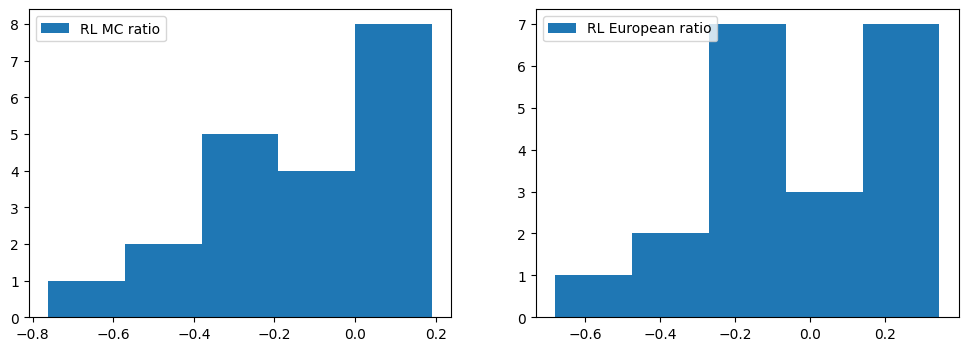

In [18]:
fig, axes = plt.subplots(1, 2, figsize=(12, 4))
for ax, col in zip(axes.flatten(), ('MC_Price', 'European_Price')):
    ax.hist((BC_gbm['RL_Price'] - BC_gbm[col]) / BC_gbm[col], bins=5, label=f"RL {col.split('_')[0]} ratio")
    ax.legend()
plt.show()

Plots

In [19]:
cols = ['s_0', 't2', 'q', 'r', 'h']
gbmcols = ['v']
hestoncols = ['v_0', 'theta', 'rho', 'kappa', 'sigma']

In [20]:
df.loc[:2, cols + gbmcols + ['gbm']]

,s_0,t2,q,r,h,v,gbm
0,80,1.0,0.0,0.04,American_Put,0.2,True
1,80,1.0,0.0,0.04,American_Put,NaN,False
2,80,2.0,0.0,0.04,American_Put,0.2,True


/home/ostapenkovs/Code/ostapenkovs/_columbia/reinforcement/_project/notebooks/../src/util.py:94: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  dummy = plt.figure()


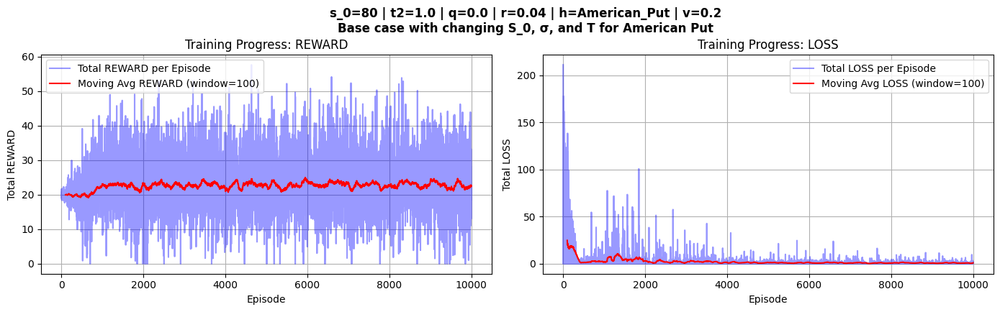

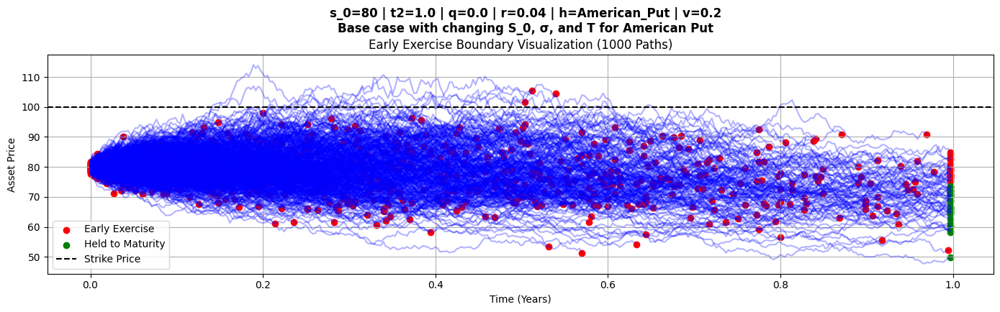

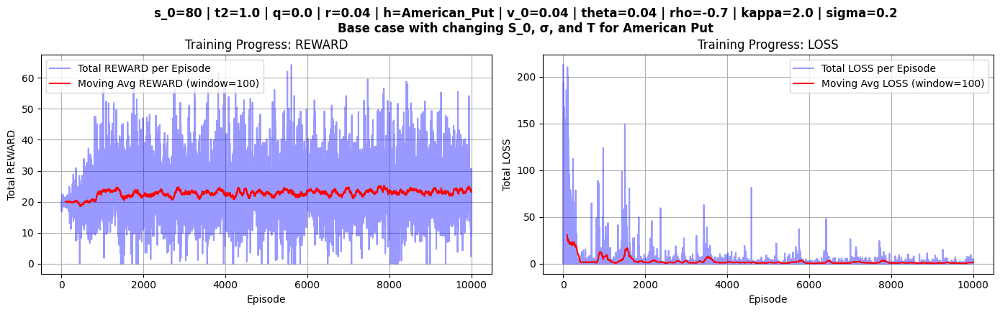

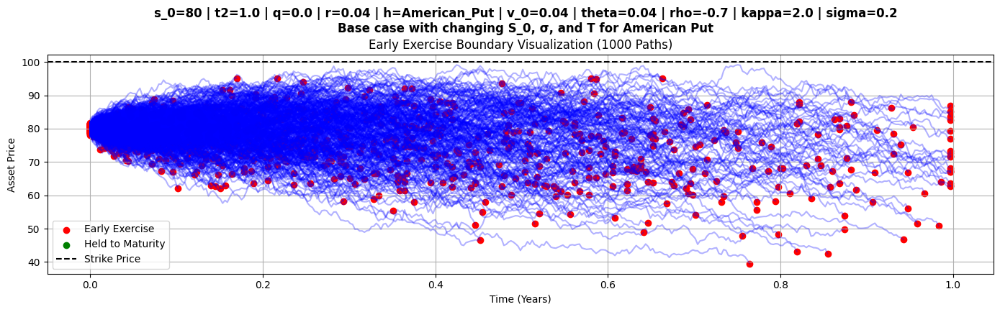

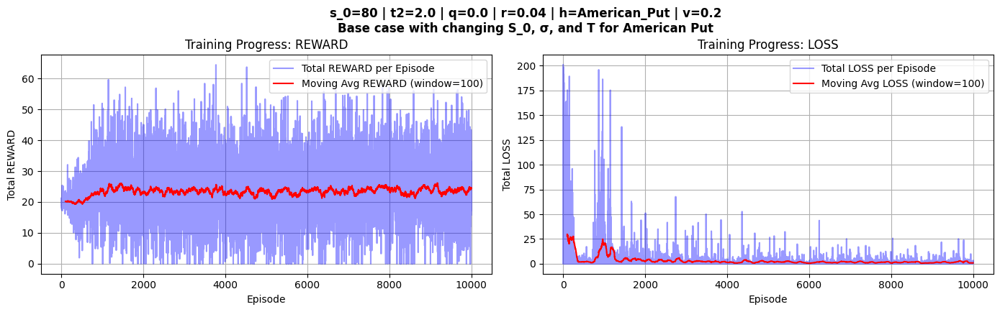

...

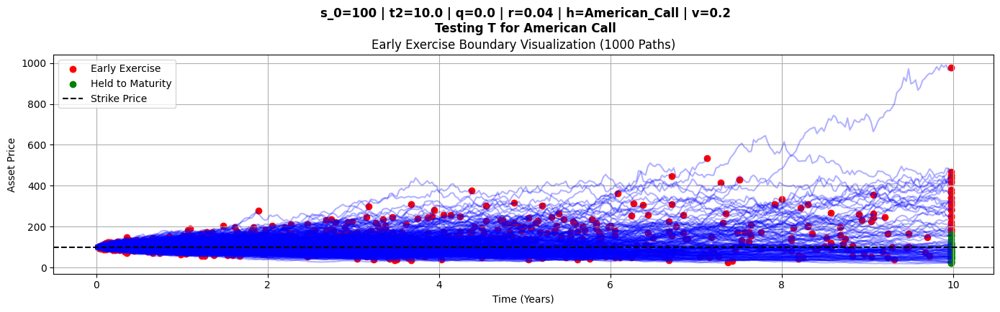

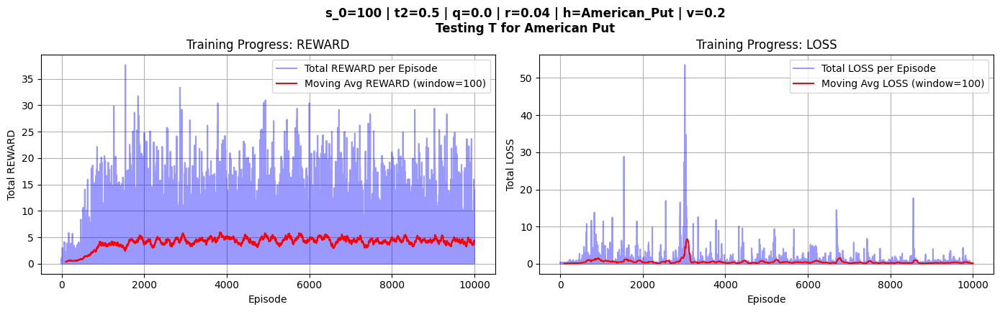

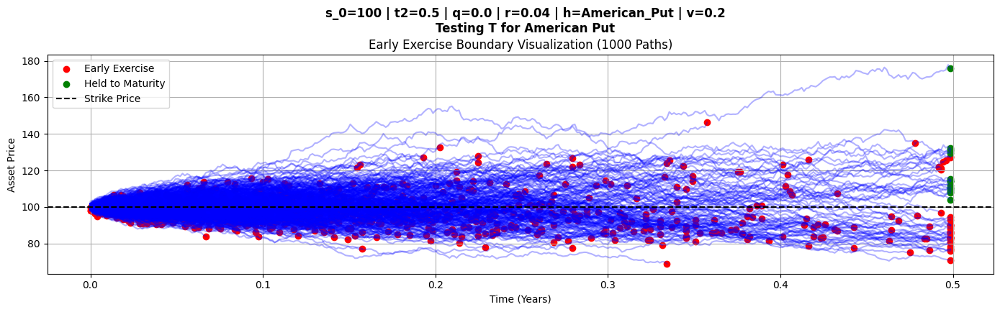

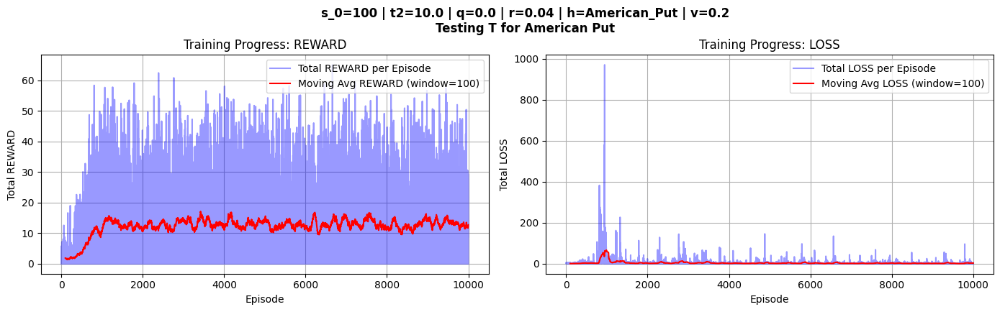

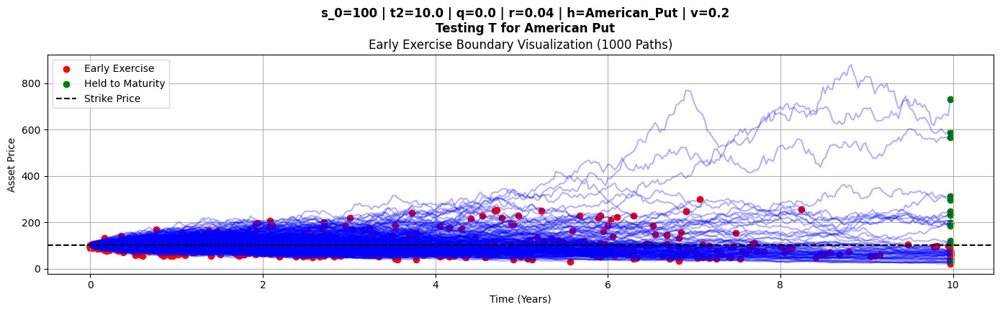

In [21]:
for i, result in enumerate(results):
    mean_reward, fig1, fig2 = result

    titlecols = cols + gbmcols if df.loc[i, 'gbm'] else cols + hestoncols
    title = ' | '.join(f"{col}={df.loc[i, col]}" for col in titlecols)
    title += f"\n{df.loc[i, 'notes']}"

    show_figure(fig1, title=title)
    show_figure(fig2, title=title)

Sandbox